<a href="https://colab.research.google.com/github/ibonetc/Esp_IA/blob/main/IA_Ejemplo_TP_Estudiantes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Integrantes

### Juan sebastian Saldarriaga
### Mario Andres Arango

Bibliografia:
https://www.kaggle.com/databeru/best-of-27-architectures-to-classify-pics-100-acc

#Librerias

In [ ]:
from sklearn.datasets import load_files       
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import seaborn as sns


import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dropout, Flatten, Conv2D,MaxPooling2D, Dense, Activation
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint, Callback, EarlyStopping
from keras.utils import np_utils
import os
from sklearn.model_selection import train_test_split
from pathlib import Path
import os.path
import pandas as pd
from time import perf_counter
from sklearn.metrics import classification_report,accuracy_score

from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array



# Funciones


In [ ]:
def create_gen():
    # Load the Images with a generator and Data Augmentation
    train_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input,
        validation_split=0.1
    )

    test_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input
    )

    train_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
        seed=0,
        subset='training',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest"
    )

    val_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
        seed=0,
        subset='validation',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest"
    )

    test_images = test_generator.flow_from_dataframe(
        dataframe=test_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=False
    )
    
    return train_images,val_images,test_images


def create_gen2():
    # Load the Images with a generator and Data Augmentation
    train_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input,
        validation_split=0.1
    )
    
    test_generator = tf.keras.preprocessing.image.ImageDataGenerator(
        preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input
    )

    train_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
        seed=0,
        subset='training',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest"
    )

    val_images = train_generator.flow_from_dataframe(
        dataframe=train_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
        seed=0,
        subset='validation',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest"
    )

    test_images = test_generator.flow_from_dataframe(
        dataframe=test_df,
        x_col='Filepath',
        y_col='Label',
        target_size=(224, 224),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        shuffle=False
    )
    
    return train_generator,test_generator,train_images,val_images,test_images

In [ ]:
def get_model(model):
# Load the pretained model
    kwargs =    {'input_shape':(224, 224, 3),
                'include_top':False,
                'weights':'imagenet',
                'pooling':'avg'}
    
    pretrained_model = model(**kwargs)
    pretrained_model.trainable = False
    
    inputs = pretrained_model.input

    x = tf.keras.layers.Dense(128, activation='relu')(pretrained_model.output)
    x = tf.keras.layers.Dense(128, activation='relu')(x)

    outputs = tf.keras.layers.Dense(4, activation='softmax')(x)

    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model


In [ ]:
def plot_training(history):
    
  acc=history.history['accuracy']
  val_acc=history.history['val_accuracy']
  epoch=range(len(acc))
  loss=history.history['loss']
  val_loss=history.history['val_loss']
  f,ax=plt.subplots(1,2,figsize=(8,4))
  ax[0].plot(epoch,acc,'blue',label='Training Accuracy')
  ax[0].plot(epoch,val_acc,'red',label='Validation Accuracy')
  ax[0].legend()
  ax[1].plot(epoch,loss,'blue',label='Training Loss')
  ax[1].plot(epoch,val_loss,'red',label='Validation Loss')
  ax[1].legend()
  plt.show()

In [ ]:
def proc_img(filepath,labels):
    """ Create a DataFrame with the filepath and the labels of the pictures
    """

    filepath = pd.Series(filepath, name='Filepath').astype(str)
    labels = pd.Series(labels, name='Label')

    # Concatenate filepaths and labels
    df = pd.concat([filepath, labels], axis=1)

    # Shuffle the DataFrame and reset index
    df = df.sample(frac=1,random_state=0).reset_index(drop = True)
    
    return df

In [ ]:
def print_test_predictions(model, n_images):
  indices= np.random.randint(0,test_df.shape[0],(1,n_images))
  paths = list(test_df.iloc[indices[0],0])
  for i in paths:
    fileImage=i
    img = load_img(fileImage, target_size =(224,224,3))
    img = img_to_array(img)
    img = img / 255
    img = np.expand_dims(img,axis=0)
    plt.figure(figsize=(6,6))
    plt.imshow(img[0])
    plt.show()
    preds=model.predict(img)
    df = pd.DataFrame(zip([int(i) for i in preds[0]*100],labels),columns=['Probabilidad','Etiqueta'])
    df.sort_values(by='Probabilidad',inplace=True,ascending=False)
    display(df.head(2))

def get_predictions(model,path):
  fileImage = path
  img = load_img(fileImage, target_size =(224,224,3))
  img = img_to_array(img)
  img = img / 255
  img = np.expand_dims(img,axis=0)
  preds=model.predict(img)
  return preds

def get_net_output(df,model,net_output_shape = None):
  outputs = np.zeros((df.shape[0],net_output_shape)) ; c=0
  for image in list(df['Filepath']):
    b = len(list(train_df['Filepath']))
    a = c/b*100
    if a%10 == 0:
      print(f'{a}%')
    output = get_predictions(model,image)
    outputs[c,:] = output[0,:]
    c+=1
  return outputs


#Preprocesamiento Datos

In [ ]:
#Para Juan
!unzip '/content/drive/MyDrive/eia/DL/Trabajos/Act1/africa.zip'

In [ ]:
#Para Mario
!unzip '/content/drive/MyDrive/Deep Learning/Computer Vision/Datasets/africa.zip'

Archive:  /content/drive/MyDrive/Deep Learning/Computer Vision/Datasets/africa.zip
   creating: db/
  inflating: db/buffalo-0001.jpg     
  inflating: db/buffalo-0003.jpg     
  inflating: db/buffalo-0005.jpg     
  inflating: db/buffalo-0007.jpg     
  inflating: db/buffalo-0009.jpg     
  inflating: db/buffalo-0011.jpg     
  inflating: db/buffalo-0013.jpg     
  inflating: db/buffalo-0015.jpg     
  inflating: db/buffalo-0017.jpg     
  inflating: db/buffalo-0019.jpg     
  inflating: db/buffalo-0021.jpg     
  inflating: db/buffalo-0023.jpg     
  inflating: db/buffalo-0025.jpg     
  inflating: db/buffalo-0027.jpg     
  inflating: db/buffalo-0029.jpg     
  inflating: db/buffalo-0031.jpg     
  inflating: db/buffalo-0033.jpg     
  inflating: db/buffalo-0035.jpg     
  inflating: db/buffalo-0037.jpg     
  inflating: db/buffalo-0039.jpg     
  inflating: db/buffalo-0041.jpg     
  inflating: db/buffalo-0043.jpg     
  inflating: db/buffalo-0045.jpg     
  inflating: db/buffalo-00

In [ ]:
PATH = "/content"

In [ ]:
os.listdir(f'{PATH}/db')

In [ ]:
fnames_train = np.array([f'{PATH}/db/{f}' for f in (os.listdir(f'{PATH}/db'))])

labels_train_array = []
for fname in fnames_train:
  if 'buffalo' in fname:
    labels_train_array.append(0)
  elif 'elephant' in fname:
    labels_train_array.append(1)
  elif 'rhino' in fname:
    labels_train_array.append(2)
  else : 
    labels_train_array.append(3)

labels_train=np.array(labels_train_array)

In [ ]:
labels = ['buffalo','elephant','rhino','zebra']

In [ ]:
np.unique(labels_train,return_counts=True)

(array([0, 1, 2, 3]), array([376, 376, 376, 376]))

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'Africa')

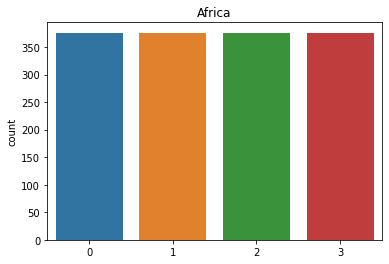

In [ ]:
sns.countplot(labels_train)
plt.title('Africa')

In [ ]:
def read_image(file_path, ROWS = 64,COLS = 64):
  img = cv2.imread(file_path, cv2.IMREAD_COLOR)
  return cv2.resize(img, (ROWS, COLS))

In [ ]:
def prep_data(images, ROWS = 64,COLS = 64,CHANNELS=3):
  count = len(images)
  data = np.ndarray((count, ROWS, COLS, CHANNELS))
  for i, image_file in enumerate(images):
    image = read_image(image_file,ROWS,COLS)
    data[i] = image   
  return data

In [ ]:
ROWS = 224
COLS = 224
CHANNELS = 3
train = prep_data(fnames_train,ROWS=ROWS,COLS=COLS)

In [ ]:
train=train/255.0

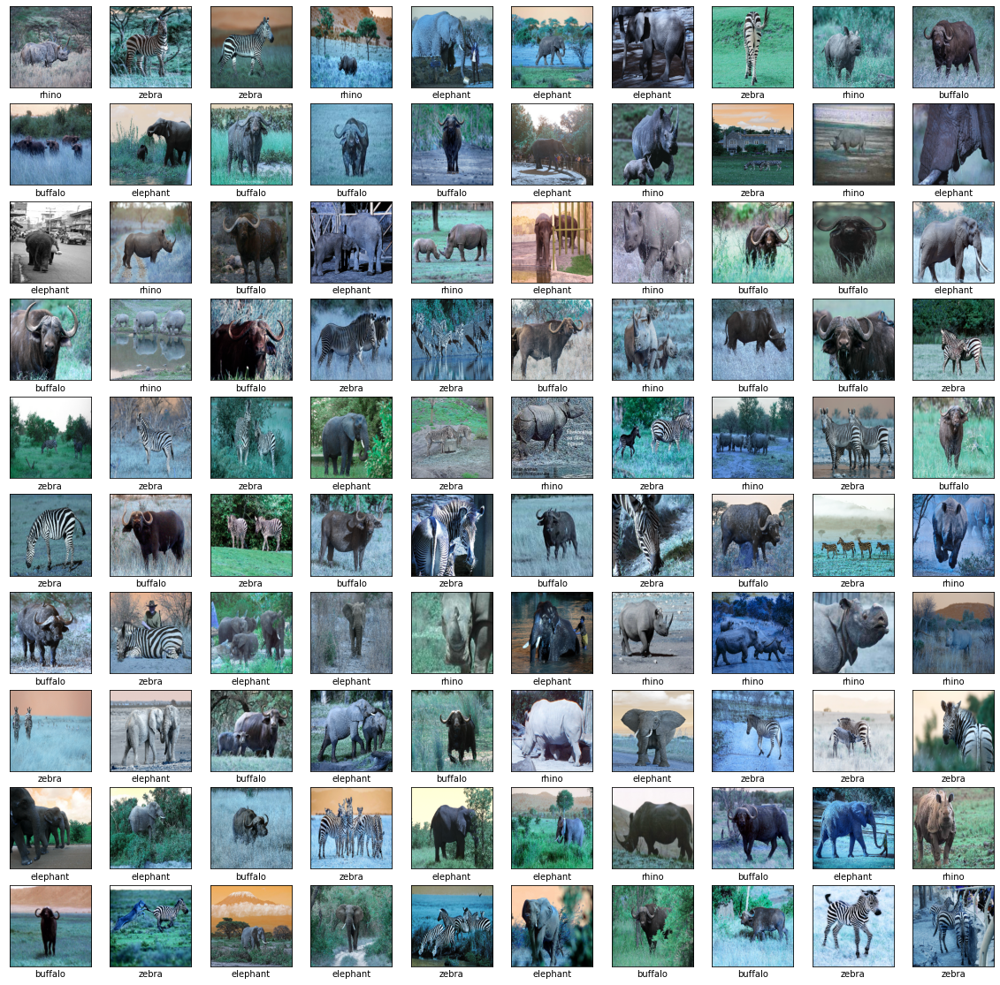

In [ ]:
plt.figure(figsize=(20,20))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(train[i])
    plt.xlabel(labels[labels_train[i]])
plt.show()





# Preprocesamiento Datos 2

In [ ]:
dir_ = Path('../content/db')
filepaths = list(dir_.glob(r'**/*.jpg'))


In [ ]:
labels_train_array = []
for fname in [str(i)for i in filepaths]:
  if 'buffalo' in fname:
    labels_train_array.append('buffalo')
  elif 'elephant' in fname:
    labels_train_array.append('elephant')
  elif 'rhino' in fname:
    labels_train_array.append('rhino')
  else : 
    labels_train_array.append('zebra')

labels_train=np.array(labels_train_array)

In [ ]:
print(len(labels_train))
print(len(filepaths))
df = proc_img(filepaths,labels_train)

print(f'Number of pictures: {df.shape[0]}\n')
print(f'Number of different labels: {len(df.Label.unique())}\n')
print(f'Labels: {df.Label.unique()}')

# The DataFrame with the filepaths in one column and the labels in the other one

df.head(10)

1501
1501
Number of pictures: 1501

Number of different labels: 4

Labels: ['rhino' 'elephant' 'zebra' 'buffalo']


,Filepath,Label
0,../content/db/rhino-0593.jpg,rhino
1,../content/db/rhino-0259.jpg,rhino
2,../content/db/rhino-0493.jpg,rhino
3,../content/db/elephant-0663.jpg,elephant
4,../content/db/zebra-0213.jpg,zebra
5,../content/db/buffalo-0065.jpg,buffalo
6,../content/db/zebra-0187.jpg,zebra
7,../content/db/elephant-0153.jpg,elephant
8,../content/db/buffalo-0163.jpg,buffalo
9,../content/db/buffalo-0455.jpg,buffalo


In [ ]:
train_df,test_df = train_test_split(df.sample(frac=0.2), test_size=0.1,random_state=0)

In [ ]:
models = {
    "DenseNet121": {"model":tf.keras.applications.DenseNet121, "perf":0},
    "MobileNetV2": {"model":tf.keras.applications.MobileNetV2, "perf":0},
    "DenseNet169": {"model":tf.keras.applications.DenseNet169, "perf":0},
    "DenseNet201": {"model":tf.keras.applications.DenseNet201, "perf":0},
    "EfficientNetB0": {"model":tf.keras.applications.EfficientNetB0, "perf":0},
    "EfficientNetB1": {"model":tf.keras.applications.EfficientNetB1, "perf":0},
    "EfficientNetB2": {"model":tf.keras.applications.EfficientNetB2, "perf":0},
    "EfficientNetB3": {"model":tf.keras.applications.EfficientNetB3, "perf":0},
    "EfficientNetB4": {"model":tf.keras.applications.EfficientNetB4, "perf":0},
    "EfficientNetB5": {"model":tf.keras.applications.EfficientNetB4, "perf":0},
    "EfficientNetB6": {"model":tf.keras.applications.EfficientNetB4, "perf":0},
    "EfficientNetB7": {"model":tf.keras.applications.EfficientNetB4, "perf":0},
    "InceptionResNetV2": {"model":tf.keras.applications.InceptionResNetV2, "perf":0},
    "InceptionV3": {"model":tf.keras.applications.InceptionV3, "perf":0},
    "MobileNet": {"model":tf.keras.applications.MobileNet, "perf":0},
    "MobileNetV2": {"model":tf.keras.applications.MobileNetV2, "perf":0},
    "MobileNetV3Large": {"model":tf.keras.applications.MobileNetV3Large, "perf":0},
    "MobileNetV3Small": {"model":tf.keras.applications.MobileNetV3Small, "perf":0},
#     "NASNetLarge": {"model":tf.keras.applications.NASNetLarge, "perf":0}, Deleted because the input shape has to be another one
    "NASNetMobile": {"model":tf.keras.applications.NASNetMobile, "perf":0},
    "ResNet101": {"model":tf.keras.applications.ResNet101, "perf":0},
    "ResNet101V2": {"model":tf.keras.applications.ResNet101V2, "perf":0},
    "ResNet152": {"model":tf.keras.applications.ResNet152, "perf":0},
    "ResNet152V2": {"model":tf.keras.applications.ResNet152V2, "perf":0},
    "ResNet50": {"model":tf.keras.applications.ResNet50, "perf":0},
    "ResNet50V2": {"model":tf.keras.applications.ResNet50V2, "perf":0},
    "VGG16": {"model":tf.keras.applications.VGG16, "perf":0},
    "VGG19": {"model":tf.keras.applications.VGG19, "perf":0},
    "Xception": {"model":tf.keras.applications.Xception, "perf":0}
}

# Create the generators
train_generator,test_generator,train_images,val_images,test_images=create_gen2()
print('\n')

# Fit the models
for name, model in models.items():
    
    # Get the model
    m = get_model(model['model'])
    models[name]['model'] = m
    
    start = perf_counter()
    
    # Fit the model
    history = m.fit(train_images,validation_data=val_images,epochs=1,verbose=0)
    
    # Sav the duration and the val_accuracy
    duration = perf_counter() - start
    duration = round(duration,2)
    models[name]['perf'] = duration
    print(f"{name:20} trained in {duration} sec")
    
    val_acc = history.history['val_accuracy']
    models[name]['val_acc'] = [round(v,4) for v in val_acc]

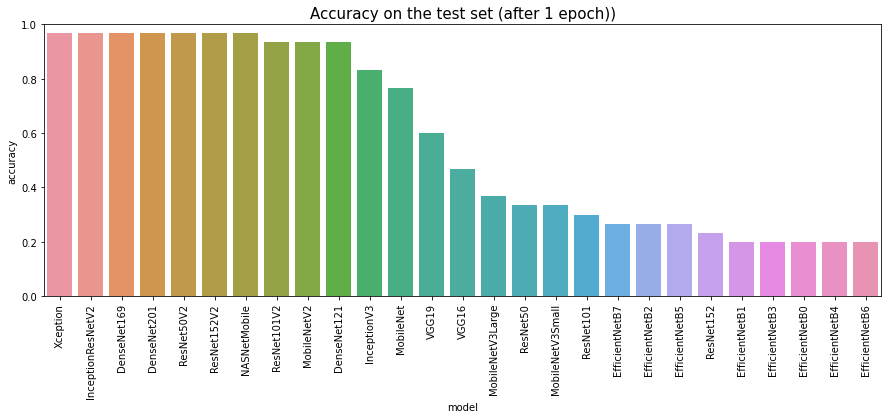

In [ ]:
for name, model in models.items():
    
    # Predict the label of the test_images
    pred = models[name]['model'].predict(test_images)
    pred = np.argmax(pred,axis=1)

    # Map the label
    labels = (train_images.class_indices)
    labels = dict((v,k) for k,v in labels.items())
    pred = [labels[k] for k in pred]

    y_test = list(test_df.Label)
    acc = accuracy_score(y_test,pred)
    models[name]['acc'] = round(acc,4)
#     printmd(f'**{name} has a {acc * 100:.2f}% accuracy on the test set**')

# Create a DataFrame with the results
models_result = []

for name, v in models.items():
    models_result.append([ name, models[name]['val_acc'][-1], 
                          models[name]['acc'],
                          models[name]['perf']])
    
df_results = pd.DataFrame(models_result, 
                          columns = ['model','val_accuracy','accuracy','Training time (sec)'])
df_results.sort_values(by='accuracy', ascending=False, inplace=True)
df_results.reset_index(inplace=True,drop=True)
df_results

plt.figure(figsize = (15,5))
sns.barplot(x = 'model', y = 'accuracy', data = df_results)
plt.title('Accuracy on the test set (after 1 epoch))', fontsize = 15)
plt.ylim(0,1)
plt.xticks(rotation=90)
plt.show()

In [ ]:
train_df,test_df = train_test_split(df, test_size=0.1, random_state=0)
train_images,val_images,test_images=create_gen()
test_df.reset_index(inplace=True)
test_df.drop(columns=['index'],inplace=True)

Found 1215 validated image filenames belonging to 4 classes.
Found 135 validated image filenames belonging to 4 classes.
Found 151 validated image filenames belonging to 4 classes.


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
labels = (train_images.class_indices)
labels = dict((v,k) for k,v in labels.items())
labels = list(labels.values())
labels

['buffalo', 'elephant', 'rhino', 'zebra']

#Modelo VGG16

58892288/58889256 [==============================] - 1s 0us/step
Epoch 1/40
38/38 [==============================] - 67s 820ms/step - loss: 1.0087 - accuracy: 0.6091 - val_loss: 0.6715 - val_accuracy: 0.7852
Epoch 2/40
38/38 [==============================] - 21s 564ms/step - loss: 0.5446 - accuracy: 0.8156 - val_loss: 0.3587 - val_accuracy: 0.9185
Epoch 3/40
38/38 [==============================] - 24s 621ms/step - loss: 0.3602 - accuracy: 0.8840 - val_loss: 0.2502 - val_accuracy: 0.9407
Epoch 4/40
38/38 [==============================] - 21s 556ms/step - loss: 0.2697 - accuracy: 0.9095 - val_loss: 0.2519 - val_accuracy: 0.9185
Epoch 5/40
38/38 [==============================] - 21s 561ms/step - loss: 0.2589 - accuracy: 0.9103 - val_loss: 0.2045 - val_accuracy: 0.9185
Epoch 6/40
38/38 [==============================] - 27s 707ms/step - loss: 0.2167 - accuracy: 0.9251 - val_loss: 0.1813 - val_accuracy: 0.9407
Epoch 7/40
38/38 [==============================] - 21s 555ms/step - loss: 0.

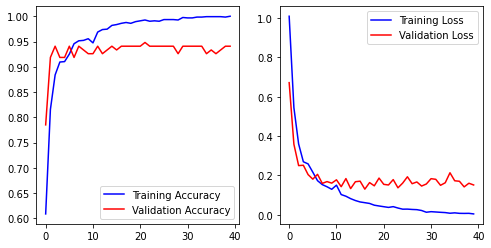

In [ ]:
model = get_model(tf.keras.applications.VGG16)
history = model.fit(train_images,validation_data=val_images,epochs=40)

plot_training(history)

#Modelo Xception

Epoch 1/5
38/38 [==============================] - 24s 587ms/step - loss: 0.2769 - accuracy: 0.9144 - val_loss: 0.0845 - val_accuracy: 0.9778
Epoch 2/5
38/38 [==============================] - 22s 584ms/step - loss: 0.1082 - accuracy: 0.9646 - val_loss: 0.0907 - val_accuracy: 0.9704
Epoch 3/5
38/38 [==============================] - 22s 569ms/step - loss: 0.0658 - accuracy: 0.9827 - val_loss: 0.0968 - val_accuracy: 0.9630
Epoch 4/5
38/38 [==============================] - 21s 556ms/step - loss: 0.0475 - accuracy: 0.9852 - val_loss: 0.0983 - val_accuracy: 0.9630
Epoch 5/5
38/38 [==============================] - 22s 590ms/step - loss: 0.0376 - accuracy: 0.9877 - val_loss: 0.1070 - val_accuracy: 0.9556



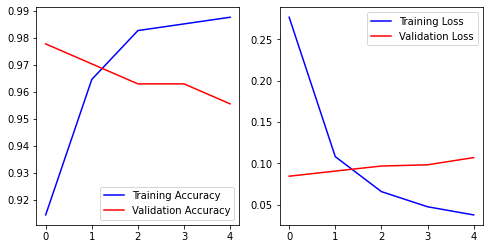

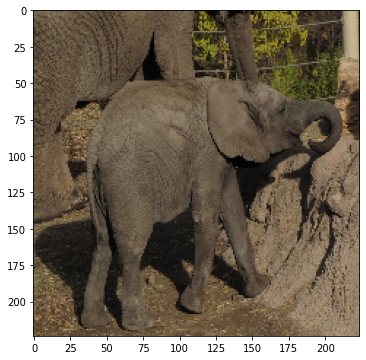

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


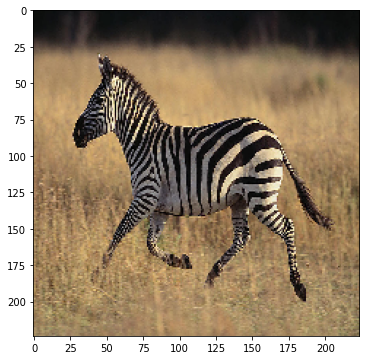

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


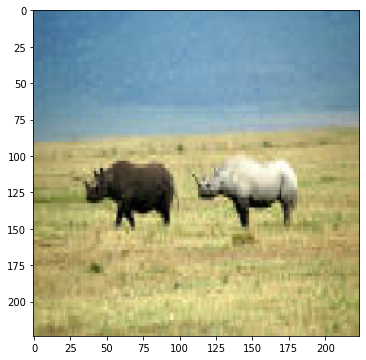

,Probabilidad,Etiqueta
2,73,rhino
0,26,buffalo


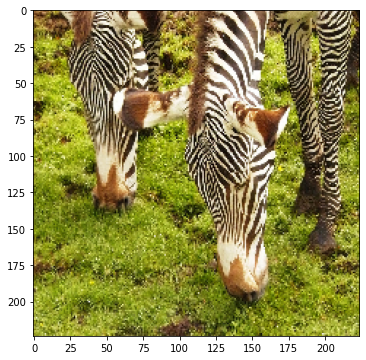

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


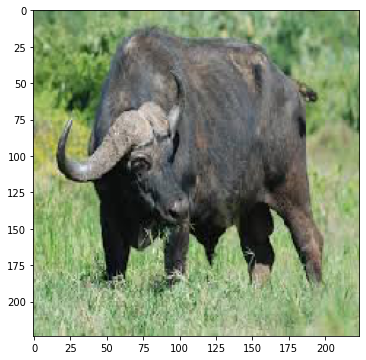

,Probabilidad,Etiqueta
0,99,buffalo
1,0,elephant


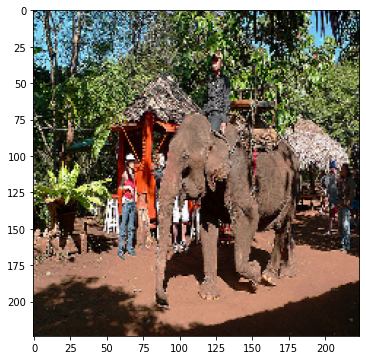

,Probabilidad,Etiqueta
1,96,elephant
3,2,zebra


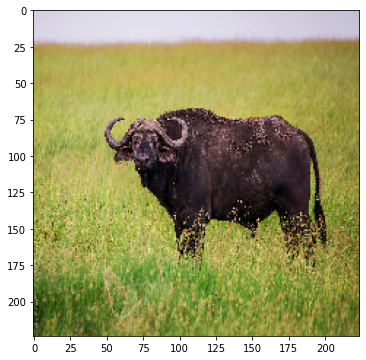

,Probabilidad,Etiqueta
0,99,buffalo
1,0,elephant


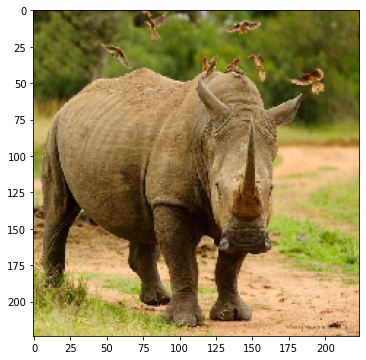

,Probabilidad,Etiqueta
2,99,rhino
0,0,buffalo


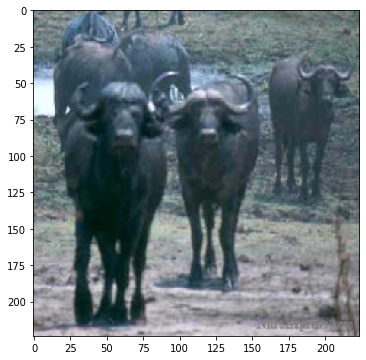

,Probabilidad,Etiqueta
0,99,buffalo
1,0,elephant


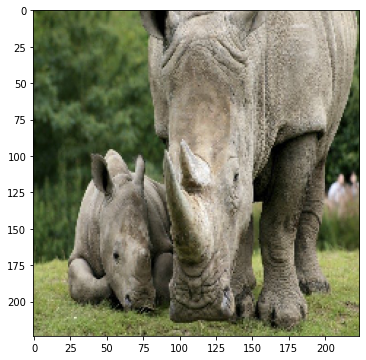

,Probabilidad,Etiqueta
2,99,rhino
0,0,buffalo


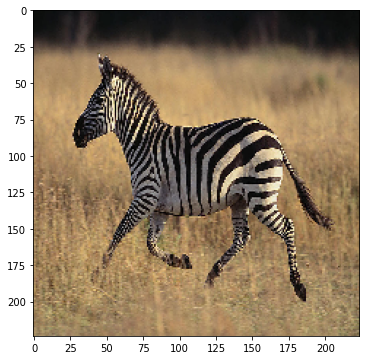

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


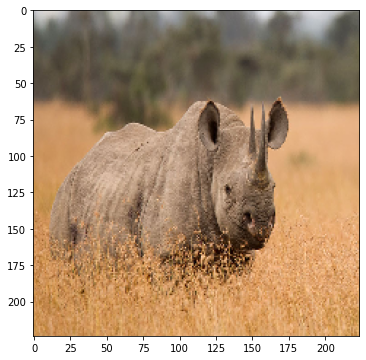

,Probabilidad,Etiqueta
2,99,rhino
0,0,buffalo


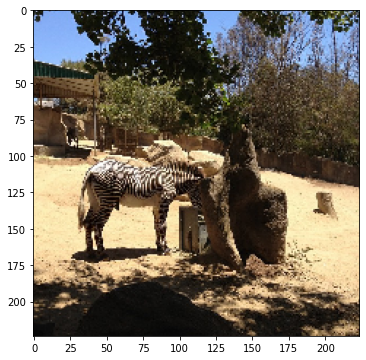

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


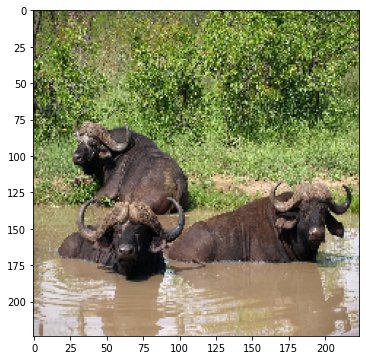

,Probabilidad,Etiqueta
0,99,buffalo
1,0,elephant


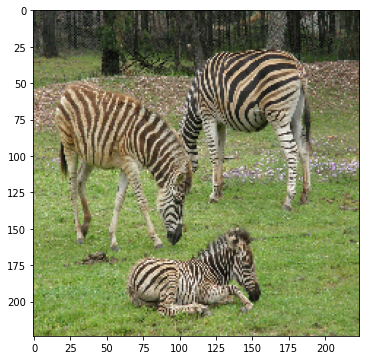

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


In [ ]:
model = get_model(tf.keras.applications.Xception)
history = model.fit(train_images,validation_data=val_images,epochs=5)
print('')
plot_training(history)
print('')
print('')
print_test_predictions(model,15)

#Modelo InceptionV3

87916544/87910968 [==============================] - 1s 0us/step
Epoch 1/30
38/38 [==============================] - 36s 751ms/step - loss: 0.2560 - accuracy: 0.9128 - val_loss: 0.1002 - val_accuracy: 0.9704
Epoch 2/30
38/38 [==============================] - 25s 665ms/step - loss: 0.1049 - accuracy: 0.9687 - val_loss: 0.0945 - val_accuracy: 0.9778
Epoch 3/30
38/38 [==============================] - 25s 640ms/step - loss: 0.0602 - accuracy: 0.9794 - val_loss: 0.1007 - val_accuracy: 0.9556
Epoch 4/30
38/38 [==============================] - 25s 667ms/step - loss: 0.0704 - accuracy: 0.9770 - val_loss: 0.1911 - val_accuracy: 0.9481
Epoch 5/30
38/38 [==============================] - 25s 661ms/step - loss: 0.0397 - accuracy: 0.9852 - val_loss: 0.1459 - val_accuracy: 0.9630
Epoch 6/30
38/38 [==============================] - 25s 670ms/step - loss: 0.0222 - accuracy: 0.9926 - val_loss: 0.1728 - val_accuracy: 0.9630
Epoch 7/30
38/38 [==============================] - 25s 671ms/step - loss: 0.

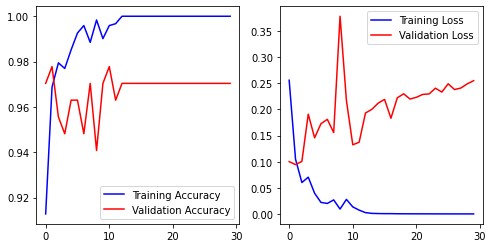

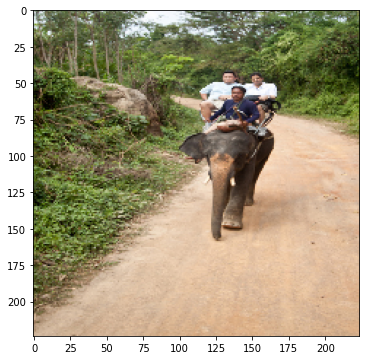

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


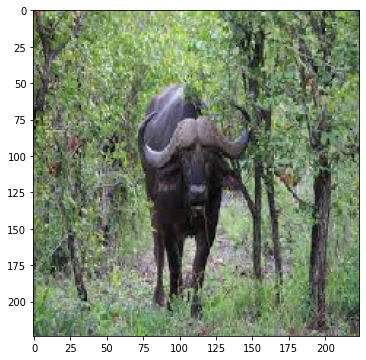

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


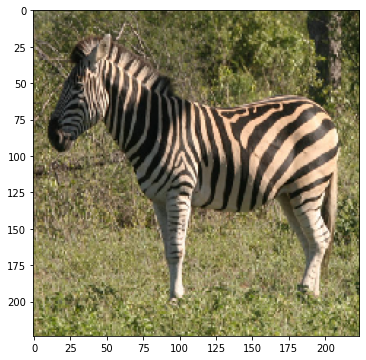

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


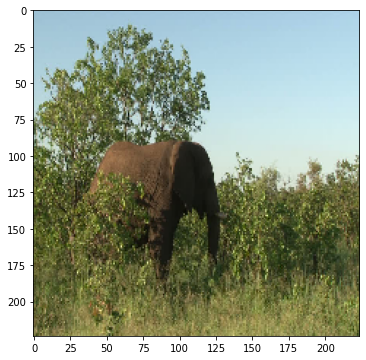

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


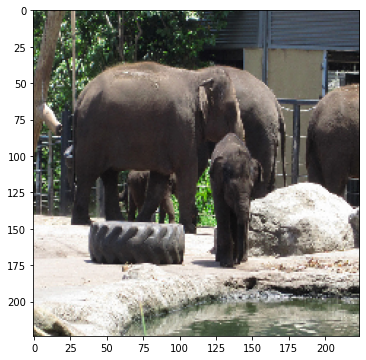

,Probabilidad,Etiqueta
1,98,elephant
2,1,rhino


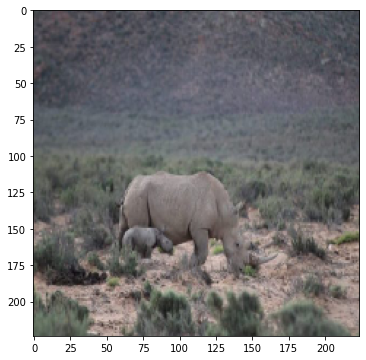

,Probabilidad,Etiqueta
2,100,rhino
0,0,buffalo


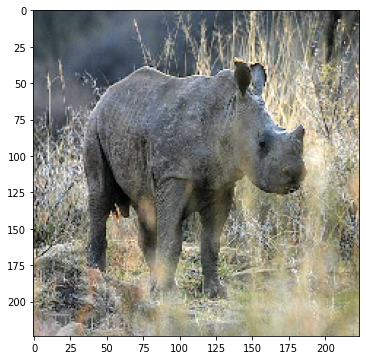

,Probabilidad,Etiqueta
2,100,rhino
0,0,buffalo


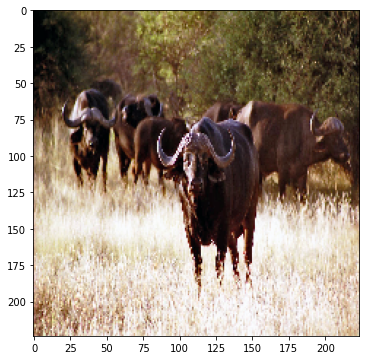

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


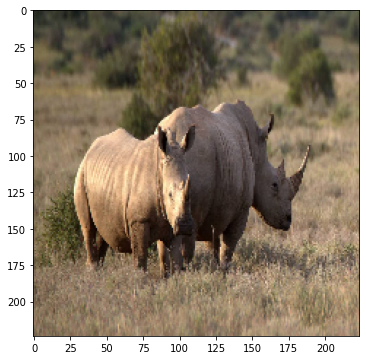

,Probabilidad,Etiqueta
2,100,rhino
0,0,buffalo


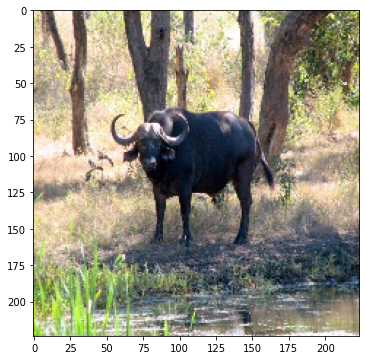

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


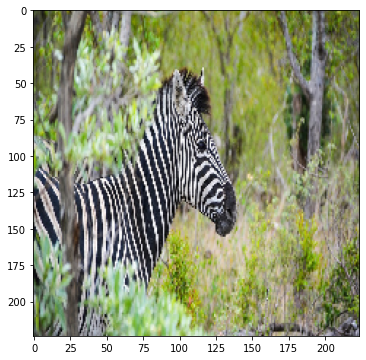

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


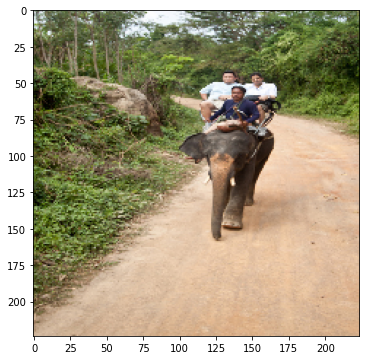

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


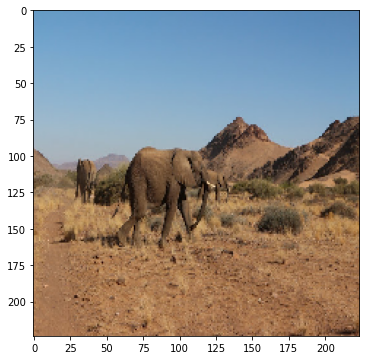

,Probabilidad,Etiqueta
2,75,rhino
1,15,elephant


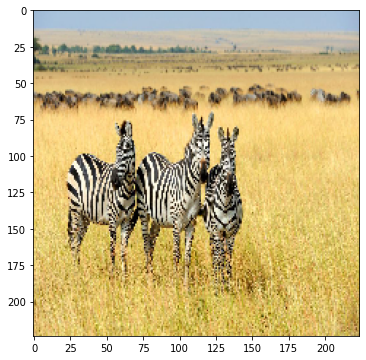

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


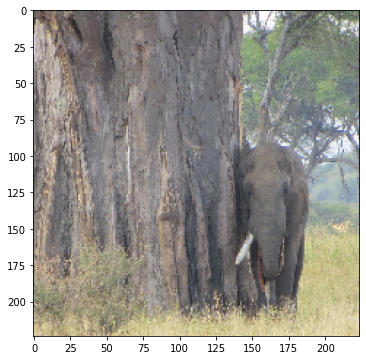

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


In [ ]:
model = get_model(tf.keras.applications.InceptionV3)
history = model.fit(train_images,validation_data=val_images,epochs=30)
print('')
plot_training(history)
print('')
print('')
print_test_predictions(model,15)

#Modelo ResNet152V2

234553344/234545216 [==============================] - 11s 0us/step
Epoch 1/30
38/38 [==============================] - 48s 954ms/step - loss: 0.2211 - accuracy: 0.9243 - val_loss: 0.1875 - val_accuracy: 0.9407
Epoch 2/30
38/38 [==============================] - 31s 794ms/step - loss: 0.0524 - accuracy: 0.9868 - val_loss: 0.1776 - val_accuracy: 0.9630
Epoch 3/30
38/38 [==============================] - 31s 806ms/step - loss: 0.0302 - accuracy: 0.9926 - val_loss: 0.1556 - val_accuracy: 0.9556
Epoch 4/30
38/38 [==============================] - 30s 794ms/step - loss: 0.0140 - accuracy: 0.9967 - val_loss: 0.1577 - val_accuracy: 0.9704
Epoch 5/30
38/38 [==============================] - 31s 796ms/step - loss: 0.0127 - accuracy: 0.9959 - val_loss: 0.1539 - val_accuracy: 0.9630
Epoch 6/30
38/38 [==============================] - 31s 801ms/step - loss: 0.0044 - accuracy: 0.9992 - val_loss: 0.1568 - val_accuracy: 0.9556
Epoch 7/30
38/38 [==============================] - 32s 853ms/step - loss:

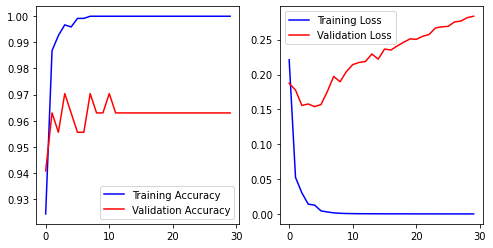

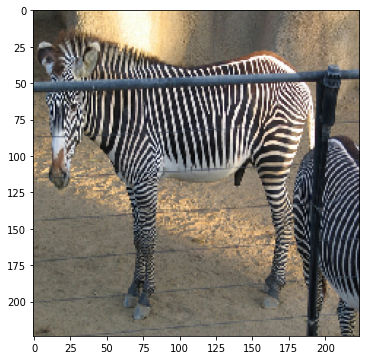

,Probabilidad,Etiqueta
3,100,zebra
0,0,buffalo


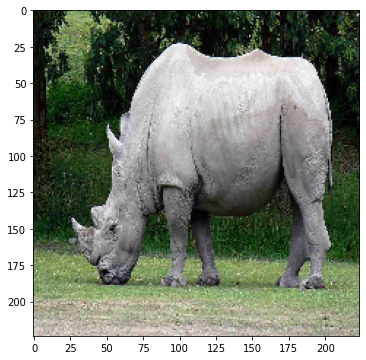

,Probabilidad,Etiqueta
2,100,rhino
0,0,buffalo


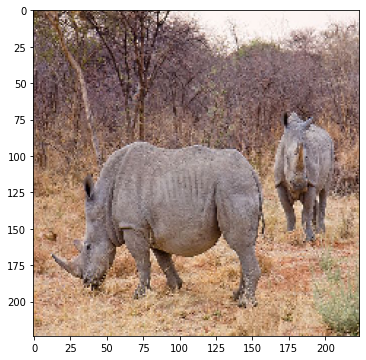

,Probabilidad,Etiqueta
2,99,rhino
0,0,buffalo


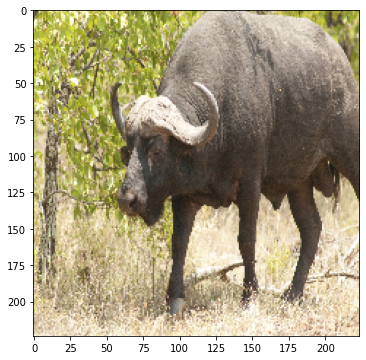

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


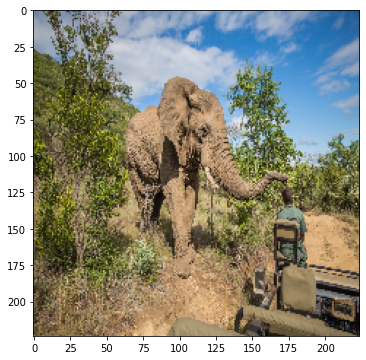

,Probabilidad,Etiqueta
1,97,elephant
3,2,zebra


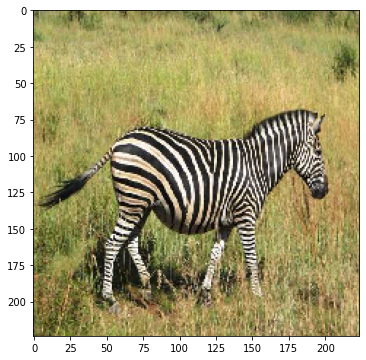

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


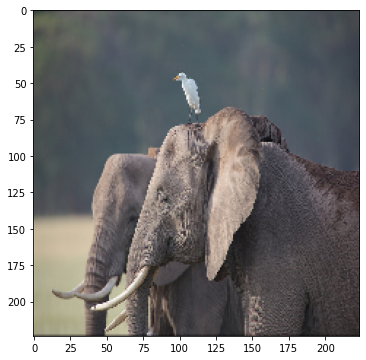

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


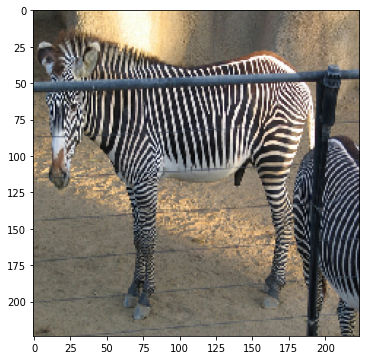

,Probabilidad,Etiqueta
3,100,zebra
0,0,buffalo


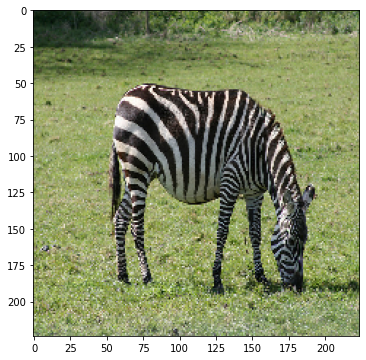

,Probabilidad,Etiqueta
3,100,zebra
0,0,buffalo


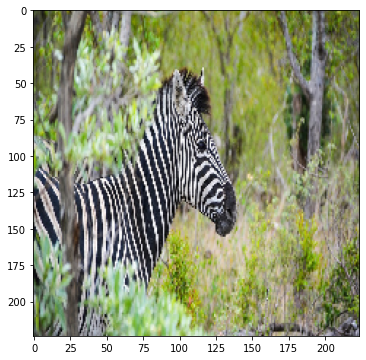

,Probabilidad,Etiqueta
3,100,zebra
0,0,buffalo


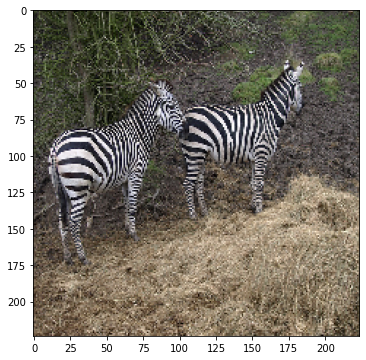

,Probabilidad,Etiqueta
3,99,zebra
0,0,buffalo


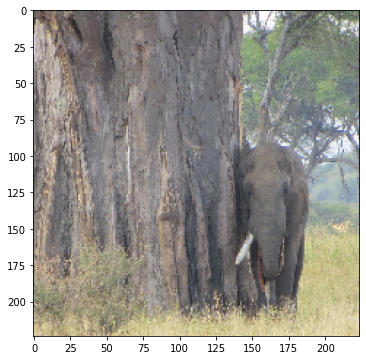

,Probabilidad,Etiqueta
1,99,elephant
0,0,buffalo


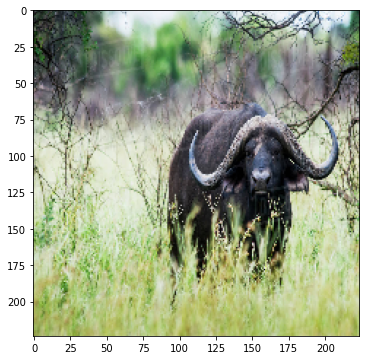

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


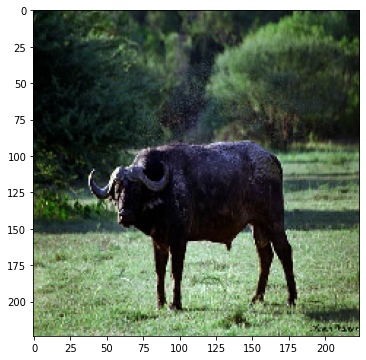

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


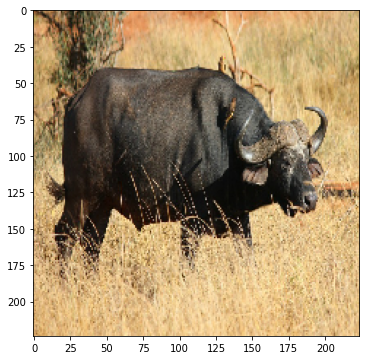

,Probabilidad,Etiqueta
0,100,buffalo
1,0,elephant


In [ ]:
model = get_model(tf.keras.applications.ResNet152V2)
history = model.fit(train_images,validation_data=val_images,epochs=30)
print('')
plot_training(history)
print('')
print('')
print_test_predictions(model,15)

#Modelo 1 

In [ ]:
classifier = Sequential()
classifier.add(Conv2D(128, (3, 3), input_shape = (224, 224, 3), activation = 'relu'))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.3))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Flatten())
classifier.add(Dropout(0.3))
classifier.add(Dense(units = 128*2, activation = 'relu'))
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 32, activation = 'relu'))
classifier.add(Dense(units = 4, activation = tf.nn.softmax))

classifier.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
history = classifier.fit(train_images,validation_data=val_images,epochs=15)
plot_training(history)

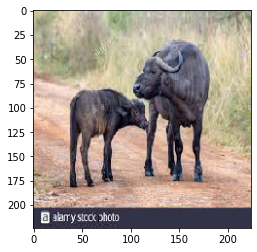

    0         1
0   0   buffalo
1  91  elephant
2   7     rhino
3   0     zebra


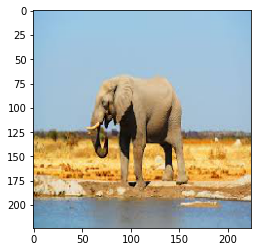

    0         1
0   0   buffalo
1  17  elephant
2  81     rhino
3   0     zebra


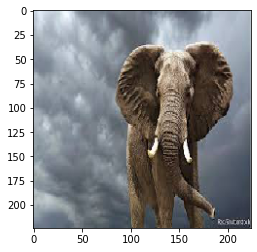

    0         1
0   0   buffalo
1  48  elephant
2  49     rhino
3   2     zebra


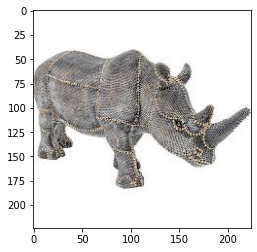

    0         1
0   0   buffalo
1  13  elephant
2  86     rhino
3   0     zebra


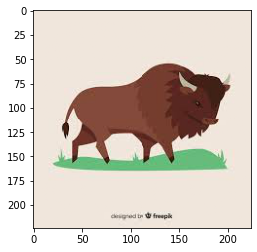

    0         1
0   0   buffalo
1  30  elephant
2  69     rhino
3   0     zebra


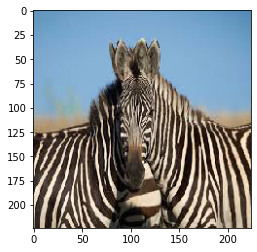

    0         1
0   0   buffalo
1  98  elephant
2   0     rhino
3   0     zebra


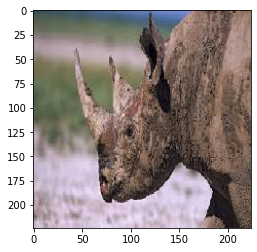

    0         1
0   0   buffalo
1   2  elephant
2  97     rhino
3   0     zebra


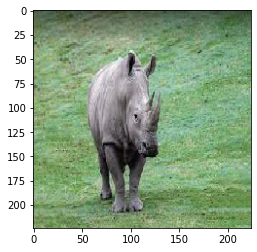

    0         1
0   0   buffalo
1  15  elephant
2  82     rhino
3   1     zebra


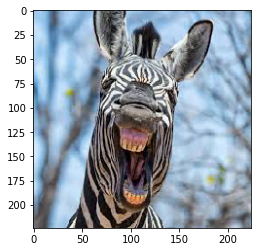

    0         1
0   0   buffalo
1  97  elephant
2   1     rhino
3   0     zebra


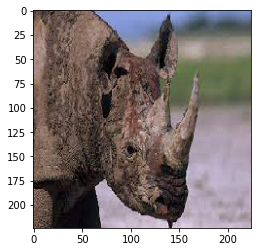

    0         1
0   1   buffalo
1  63  elephant
2  32     rhino
3   1     zebra


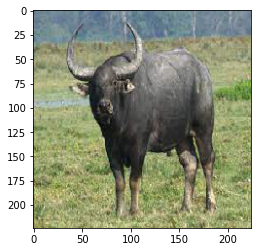

    0         1
0   0   buffalo
1  58  elephant
2  38     rhino
3   1     zebra


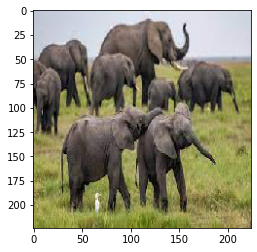

    0         1
0   0   buffalo
1   8  elephant
2  90     rhino
3   0     zebra


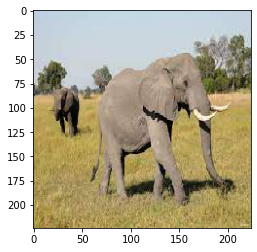

    0         1
0   0   buffalo
1   0  elephant
2  99     rhino
3   0     zebra


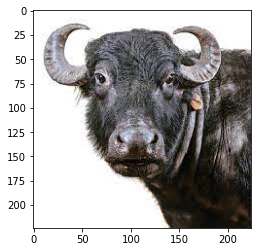

    0         1
0   0   buffalo
1  52  elephant
2  45     rhino
3   0     zebra


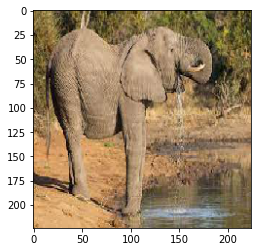

    0         1
0   1   buffalo
1   1  elephant
2  96     rhino
3   0     zebra


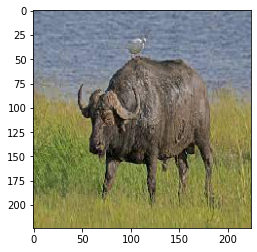

    0         1
0   2   buffalo
1  26  elephant
2  67     rhino
3   3     zebra


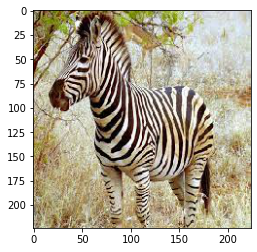

    0         1
0   0   buffalo
1  44  elephant
2   0     rhino
3  55     zebra


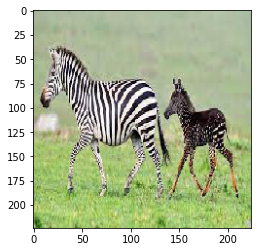

    0         1
0   0   buffalo
1  12  elephant
2   1     rhino
3  86     zebra


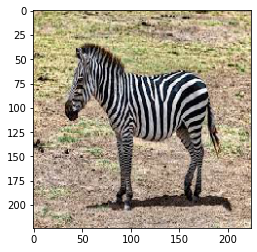

    0         1
0   0   buffalo
1  34  elephant
2   0     rhino
3  64     zebra


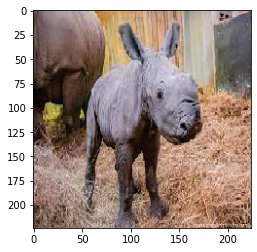

    0         1
0   0   buffalo
1   3  elephant
2  95     rhino
3   0     zebra


In [ ]:
for i in paths:
  fileImage=i
  img = load_img(fileImage, target_size =(224,224,3))
  img = img_to_array(img)
  img = img / 255
  img = np.expand_dims(img,axis=0)
  plt.imshow(img[0])
  plt.show()
  preds=classifier.predict(img)
  df = pd.DataFrame(zip([int(i) for i in preds[0]*100],labels))
  print(df)

#Modelo 2

In [ ]:
classifier = Sequential()
classifier.add(Conv2D(224, (3, 3), input_shape = (224, 224, 3), activation = 'relu'))
classifier.add(Conv2D(224, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.3))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Flatten())
classifier.add(Dropout(0.3))
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 4, activation = tf.nn.softmax))

classifier.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

Epoch 1/20
38/38 [==============================] - 55s 1s/step - loss: 1.4417 - accuracy: 0.2856 - val_loss: 1.2751 - val_accuracy: 0.3778
Epoch 2/20
38/38 [==============================] - 40s 1s/step - loss: 1.0988 - accuracy: 0.4757 - val_loss: 0.9413 - val_accuracy: 0.5556
Epoch 3/20
38/38 [==============================] - 41s 1s/step - loss: 0.9140 - accuracy: 0.5794 - val_loss: 0.8810 - val_accuracy: 0.6000
Epoch 4/20
38/38 [==============================] - 41s 1s/step - loss: 0.7782 - accuracy: 0.6831 - val_loss: 0.8442 - val_accuracy: 0.6519
Epoch 5/20
38/38 [==============================] - 41s 1s/step - loss: 0.6873 - accuracy: 0.7300 - val_loss: 0.8137 - val_accuracy: 0.6296
Epoch 6/20
38/38 [==============================] - 41s 1s/step - loss: 0.5577 - accuracy: 0.7761 - val_loss: 0.8859 - val_accuracy: 0.6519
Epoch 7/20
38/38 [==============================] - 42s 1s/step - loss: 0.3999 - accuracy: 0.8527 - val_loss: 0.9131 - val_accuracy: 0.6000
Epoch 8/20
38/38 [==

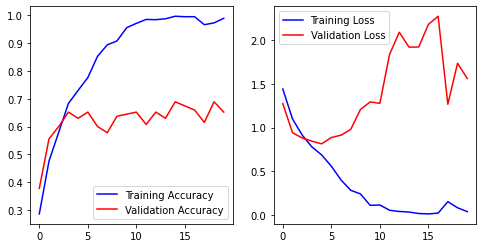

In [ ]:
history = classifier.fit(train_images,validation_data=val_images,epochs=20)
plot_training(history)

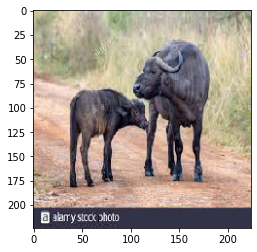

    0         1
0   7   buffalo
1  37  elephant
2  46     rhino
3   8     zebra


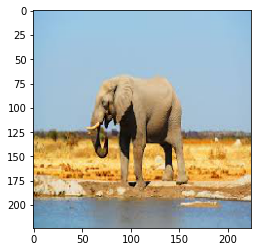

    0         1
0   7   buffalo
1  37  elephant
2  46     rhino
3   8     zebra


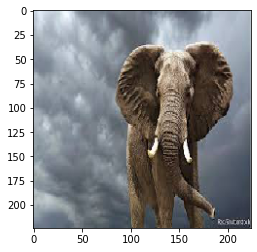

    0         1
0   5   buffalo
1  38  elephant
2  48     rhino
3   7     zebra


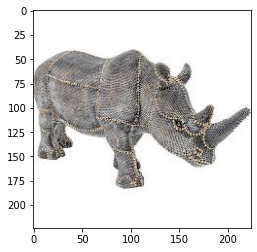

    0         1
0   6   buffalo
1  38  elephant
2  45     rhino
3   9     zebra


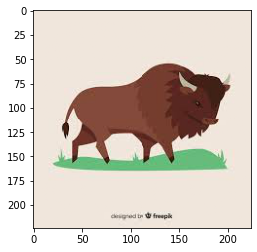

    0         1
0   6   buffalo
1  35  elephant
2  48     rhino
3   8     zebra


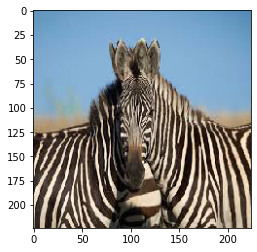

    0         1
0  13   buffalo
1  41  elephant
2  28     rhino
3  17     zebra


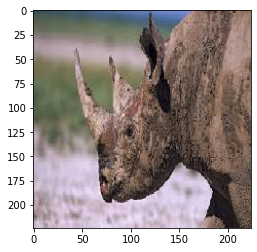

    0         1
0   5   buffalo
1  35  elephant
2  50     rhino
3   8     zebra


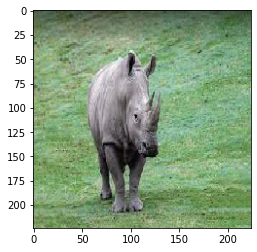

    0         1
0   9   buffalo
1  34  elephant
2  47     rhino
3   8     zebra


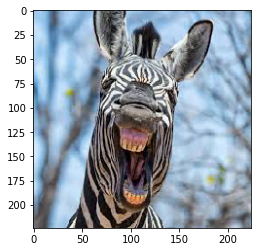

    0         1
0   5   buffalo
1  40  elephant
2  47     rhino
3   7     zebra


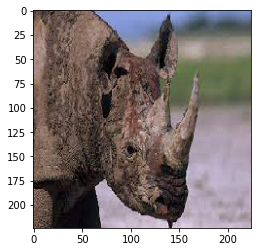

    0         1
0   5   buffalo
1  36  elephant
2  51     rhino
3   6     zebra


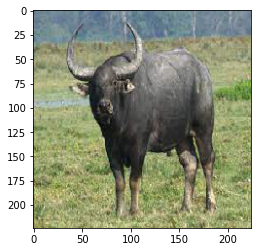

    0         1
0   7   buffalo
1  37  elephant
2  47     rhino
3   8     zebra


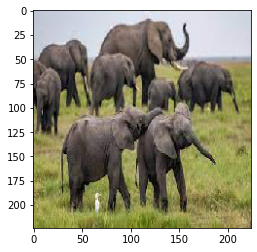

    0         1
0   5   buffalo
1  36  elephant
2  50     rhino
3   6     zebra


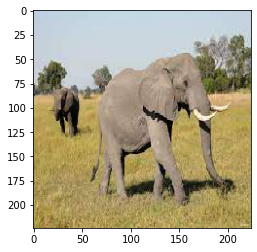

    0         1
0   6   buffalo
1  36  elephant
2  47     rhino
3   8     zebra


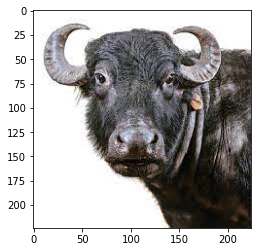

    0         1
0   5   buffalo
1  32  elephant
2  55     rhino
3   6     zebra


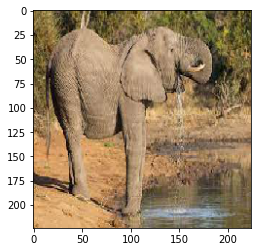

    0         1
0   8   buffalo
1  34  elephant
2  49     rhino
3   8     zebra


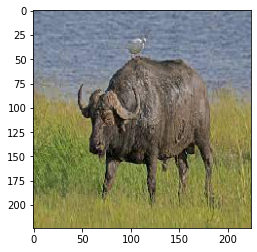

    0         1
0   7   buffalo
1  36  elephant
2  47     rhino
3   8     zebra


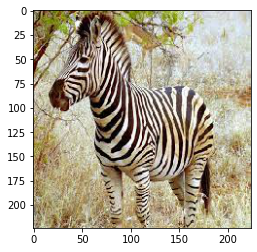

    0         1
0   7   buffalo
1  37  elephant
2  47     rhino
3   7     zebra


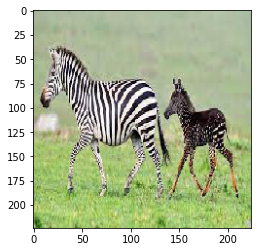

    0         1
0   1   buffalo
1  29  elephant
2  64     rhino
3   4     zebra


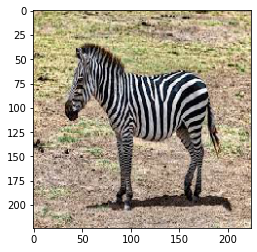

    0         1
0  30   buffalo
1  14  elephant
2  11     rhino
3  43     zebra


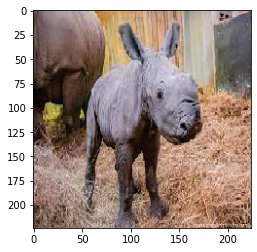

    0         1
0   8   buffalo
1  35  elephant
2  48     rhino
3   7     zebra


In [ ]:
for i in paths:
  fileImage=i
  img = load_img(fileImage, target_size =(224,224,3))
  img = img_to_array(img)
  img = img / 255
  img = np.expand_dims(img,axis=0)
  plt.imshow(img[0])
  plt.show()
  preds=classifier.predict(img)
  df = pd.DataFrame(zip([int(i) for i in preds[0]*100],labels))
  print(df)

#Modelo 3

In [ ]:
classifier = Sequential()
classifier.add(Conv2D(224, (3, 3), input_shape = (224, 224, 3), activation = 'relu'))
classifier.add(Conv2D(224, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.1))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.1))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.1))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Dropout(0.1))
classifier.add(Conv2D(16, (3, 3), activation = 'relu'))
classifier.add(Conv2D(16, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Flatten())
classifier.add(Dropout(0.5))
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 4, activation = tf.nn.softmax))

classifier.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

Epoch 1/30
38/38 [==============================] - 44s 1s/step - loss: 1.3907 - accuracy: 0.2642 - val_loss: 1.3864 - val_accuracy: 0.2667
Epoch 2/30
38/38 [==============================] - 43s 1s/step - loss: 1.3628 - accuracy: 0.3407 - val_loss: 1.3350 - val_accuracy: 0.3185
Epoch 3/30
38/38 [==============================] - 43s 1s/step - loss: 1.2220 - accuracy: 0.4165 - val_loss: 1.1484 - val_accuracy: 0.4889
Epoch 4/30
38/38 [==============================] - 43s 1s/step - loss: 1.0888 - accuracy: 0.4807 - val_loss: 1.0688 - val_accuracy: 0.5556
Epoch 5/30
38/38 [==============================] - 42s 1s/step - loss: 1.0022 - accuracy: 0.5144 - val_loss: 0.9539 - val_accuracy: 0.5111
Epoch 6/30
38/38 [==============================] - 43s 1s/step - loss: 0.9852 - accuracy: 0.5366 - val_loss: 0.9769 - val_accuracy: 0.5333
Epoch 7/30
38/38 [==============================] - 42s 1s/step - loss: 0.9573 - accuracy: 0.5473 - val_loss: 0.9333 - val_accuracy: 0.5778
Epoch 8/30
38/38 [==

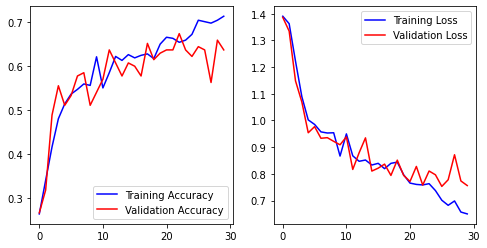

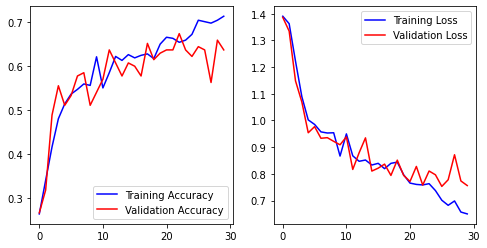

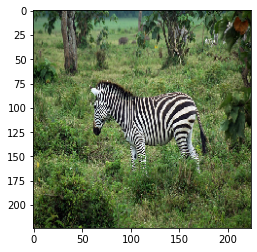

    0         1
0  10   buffalo
1  41  elephant
2  21     rhino
3  27     zebra


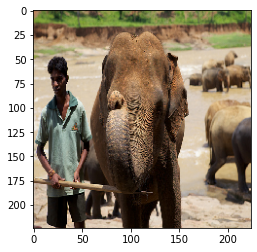

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   8     zebra


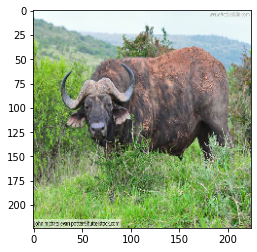

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


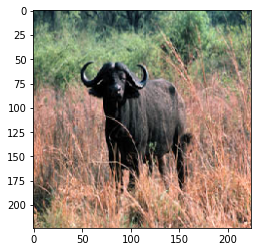

    0         1
0  13   buffalo
1  41  elephant
2  39     rhino
3   6     zebra


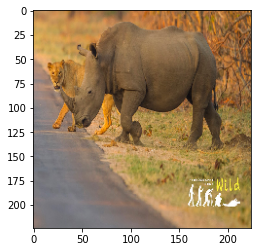

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


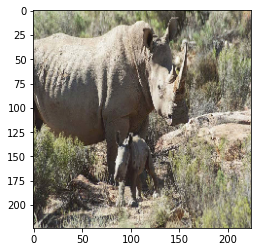

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


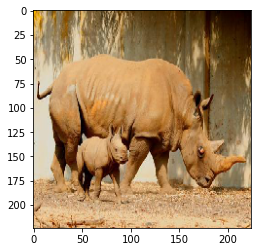

    0         1
0  12   buffalo
1  39  elephant
2  39     rhino
3   8     zebra


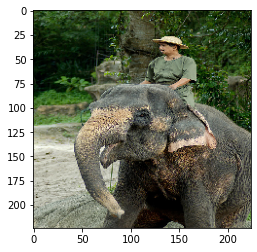

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


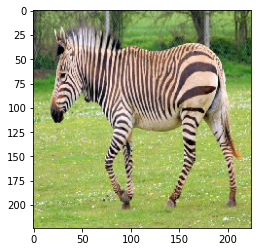

    0         1
0  11   buffalo
1  39  elephant
2  41     rhino
3   7     zebra


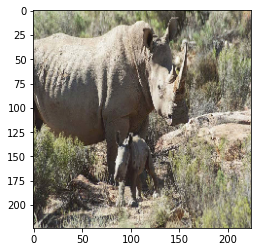

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


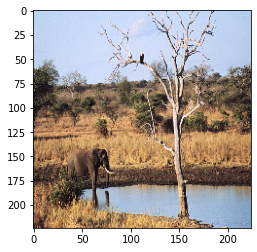

    0         1
0  11   buffalo
1  38  elephant
2  41     rhino
3   8     zebra


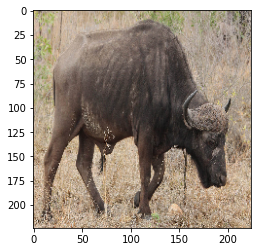

    0         1
0  12   buffalo
1  39  elephant
2  39     rhino
3   7     zebra


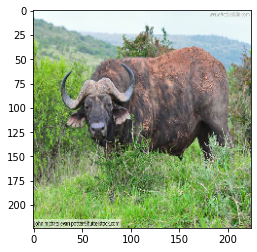

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


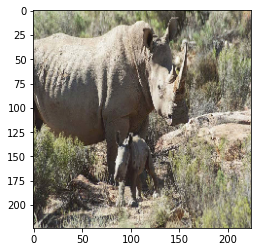

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


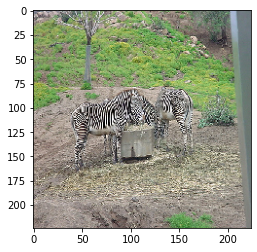

    0         1
0  10   buffalo
1  39  elephant
2  26     rhino
3  23     zebra


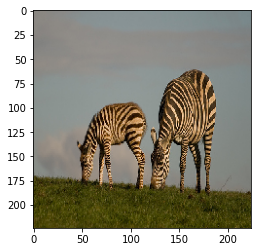

    0         1
0  12   buffalo
1  40  elephant
2  39     rhino
3   7     zebra


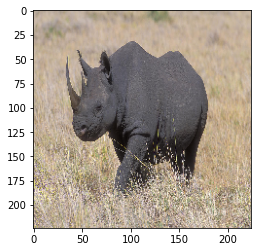

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


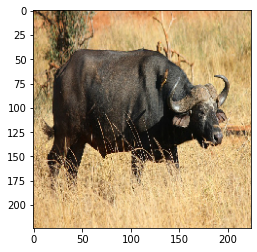

    0         1
0  11   buffalo
1  40  elephant
2  41     rhino
3   5     zebra


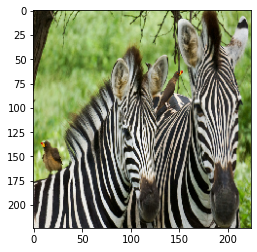

    0         1
0  11   buffalo
1  40  elephant
2  42     rhino
3   4     zebra


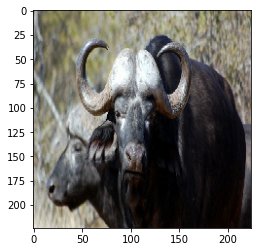

    0         1
0  12   buffalo
1  39  elephant
2  40     rhino
3   7     zebra


In [ ]:
history = classifier.fit(train_images,validation_data=val_images,batch_size=10,epochs=30)
plot_training(history)
print('')
plot_training(history)
print('')
print('')
print_test_predictions(classifier, 20)

In [ ]:
for i in paths:
  fileImage=i
  img = load_img(fileImage, target_size =(224,224,3))
  img = img_to_array(img)
  img = img / 255
  img = np.expand_dims(img,axis=0)
  plt.imshow(img[0])
  plt.show()
  preds=classifier.predict(img)
  df = pd.DataFrame(zip([int(i) for i in preds[0]*100],labels))
  print(df)

#Modelo 4

In [ ]:
classifier = Sequential()
classifier.add(Conv2D(128, (3, 3), input_shape = (224, 224, 3), activation = 'relu'))
classifier.add(Conv2D(128, (3, 3), activation = 'relu'))
classifier.add(Dropout(0.2))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(Dropout(0.2))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(Dropout(0.2))
classifier.add(MaxPooling2D(pool_size = (2, 2)))
classifier.add(Flatten())
classifier.add(Dropout(0.3))
classifier.add(Flatten())
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 4, activation = tf.nn.softmax))

classifier.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

Epoch 1/50
38/38 [==============================] - 37s 840ms/step - loss: 1.2659 - accuracy: 0.3852 - val_loss: 1.0462 - val_accuracy: 0.5259
Epoch 2/50
38/38 [==============================] - 25s 666ms/step - loss: 0.9275 - accuracy: 0.5786 - val_loss: 0.9770 - val_accuracy: 0.5704
Epoch 3/50
38/38 [==============================] - 24s 632ms/step - loss: 0.8356 - accuracy: 0.6519 - val_loss: 0.8850 - val_accuracy: 0.6593
Epoch 4/50
38/38 [==============================] - 27s 696ms/step - loss: 0.7035 - accuracy: 0.6963 - val_loss: 0.8373 - val_accuracy: 0.6444
Epoch 5/50
38/38 [==============================] - 25s 638ms/step - loss: 0.5750 - accuracy: 0.7720 - val_loss: 0.9008 - val_accuracy: 0.6296
Epoch 6/50
38/38 [==============================] - 25s 653ms/step - loss: 0.4542 - accuracy: 0.8255 - val_loss: 0.8760 - val_accuracy: 0.6741
Epoch 7/50
38/38 [==============================] - 25s 660ms/step - loss: 0.2864 - accuracy: 0.8930 - val_loss: 0.9394 - val_accuracy: 0.6370

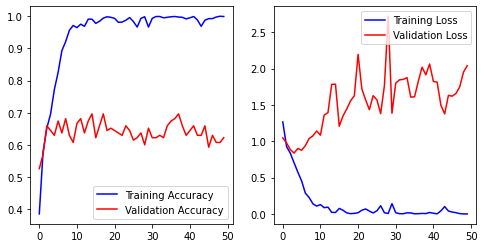

In [ ]:
history = classifier.fit(train_images,validation_data=val_images,epochs=50)
plot_training(history)

# Transformacion de datos usando VGG16

In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.model_selection import GridSearchCV

In [ ]:
kwargs =    {'input_shape':(224, 224, 3),
              'include_top':False,
              'weights':'imagenet',
              'pooling':'avg'}
model = (tf.keras.applications.VGG16(**kwargs))
train_df.reset_index(inplace=True,drop=True)

58900480/58889256 [==============================] - 1s 0us/step


In [ ]:
X

In [ ]:
df.reset_index(inplace=True,drop=True)
X = get_net_output(df,model,net_output_shape=512)
y = df['Label']
y = np.array(y)
X_train, X_test, y_train, y_test = train_test_split(X,y)

0.0%
10.0%
20.0%
30.0%
40.0%
50.0%
60.0%
70.0%
80.0%
90.0%
100.0%


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Neurona compuesta VGG16 - KNN

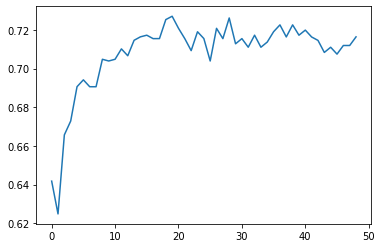

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
score = []
for i in range(1,50):
  c_model = KNeighborsClassifier(n_neighbors=i)
  score.append(cross_val_score(c_model,X_train,y_train,cv=10).mean())
  
plt.plot(score)



El accuracy es de 72.70859671302149% utilizando cross validation y n_neighbors=20




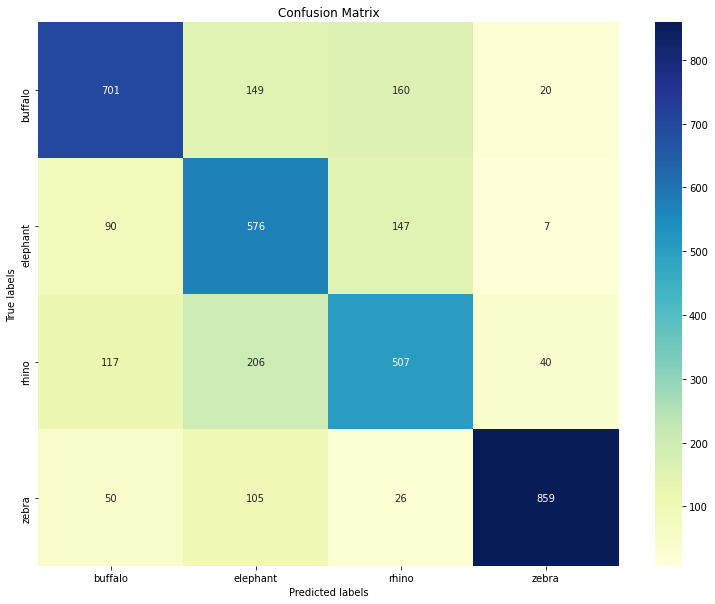

In [ ]:
c_model = KNeighborsClassifier(n_neighbors=20)
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))
for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y n_neighbors=20')
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);

#Neurona compuesta VGG16 - SVM

In [ ]:
from sklearn.svm import SVC
param_grid = [
  {'C': [1, 10, 100, 1000], 'gamma': [0.01,0.001, 0.0001], 'kernel': ['rbf','linear']}]
model_c = SVC()

model_c_cv = GridSearchCV(model_c,param_grid,cv=10,n_jobs=-1)
model_c_cv.fit(X_train,y_train)


GridSearchCV(cv=10, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='scale', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'C': [1, 10, 100, 1000],
                          'gamma': [0.01, 0.001, 0.0001],
                          'kernel': ['rbf', 'linear']}],
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [ ]:
print(model_c_cv.best_score_,model_c_cv.best_params_)

0.8568109987357776 {'C': 1, 'gamma': 0.01, 'kernel': 'linear'}


El accuracy es de 85.68109987357776% utilizando cross validation y como parametros: C: 1, gamma: 0.01, kernel: linear




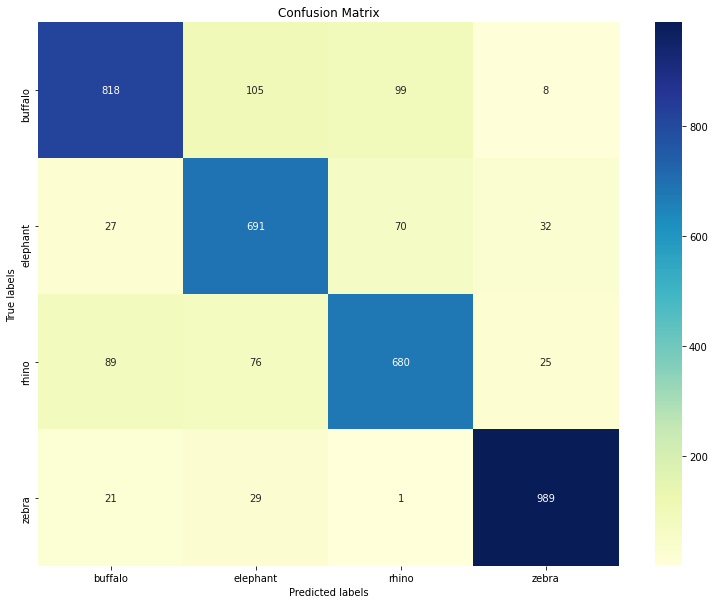

In [ ]:
c_model = SVC(C=1,gamma=0.01,kernel='linear')
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))
for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y como parametros: C: 1, gamma: 0.01, kernel: linear')
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);

#Neurona compuesta VGG16 - arboles de decision 

In [ ]:
from sklearn.tree import DecisionTreeClassifier
param_grid = [
  {'criterion':['gini', 'entropy'],
   'max_depth' : [4,8,12],
   'min_samples_split': [1,3,5],
   'min_samples_leaf': [1,3,5]}]
model_c = DecisionTreeClassifier()

model_c_cv = GridSearchCV(model_c,param_grid,cv=10,n_jobs=-1)
model_c_cv.fit(X_train,y_train)



KeyboardInterrupt: ignored

In [ ]:
print(model_c_cv.best_score_,model_c_cv.best_params_)

AttributeError: ignored

numpy.ndarray

In [ ]:
print(train_index.shape)
#print(test_index.shape)
X_train.values.shape
print(test_index)
X_train.values[[test_index]]


(1013,)


AttributeError: ignored

In [ ]:
c_model = DecisionTreeClassifier(criterion='entropy', max_depth= 12, min_samples_leaf=1, min_samples_split= 3)
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))
X_train
for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  print(train_index.shape)
  print(test_index.shape)
  print(X_train.shape)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y como parametros: criterion : entropy, max_depth: 12, min_samples_leaf: 1, min_samples_split: 3' )
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);

(1012,)
(113,)
(1125, 512)
(1012,)
(113,)
(1125, 512)
(1012,)
(113,)
(1125, 512)
(1012,)
(113,)
(1125, 512)
(1012,)
(113,)
(1125, 512)
(1013,)
(112,)
(1125, 512)
(1013,)
(112,)
(1125, 512)
(1013,)
(112,)
(1125, 512)
(1013,)
(112,)
(1125, 512)
(1013,)
(112,)
(1125, 512)


#Neurona compuesta VGG16 - random forest 

In [ ]:
from sklearn.ensemble import RandomForestClassifier
param_grid = [
  {'n_estimators' : [10,50,100,200],
   'max_depth' : [4,8,12],
   'min_samples_split': [1,3,5],
   'min_samples_leaf': [1,3,5]}]
model_c = RandomForestClassifier()

model_c_cv = GridSearchCV(model_c,param_grid,cv=10,n_jobs=-1)
model_c_cv.fit(X_train,y_train)


GridSearchCV(cv=10, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                              oob_score=False,
                                              rand

In [ ]:
print(model_c_cv.best_score_,model_c_cv.best_params_)

0.8052465233881163 {'max_depth': 12, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}


El accuracy es de 79.63653603034135% utilizando cross validation y como parametros: max_depth= 12, min_samples_leaf = 1, min_samples_split = 5, n_estimators= 200




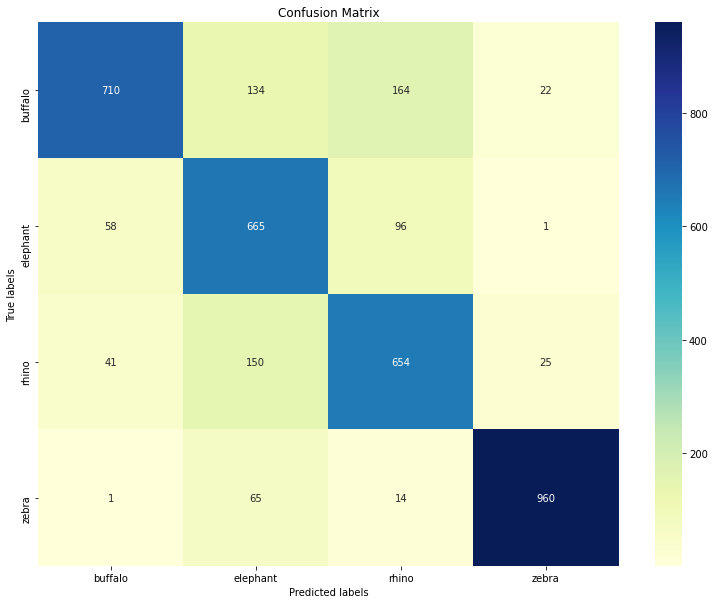

In [ ]:
c_model = RandomForestClassifier(max_depth= 12, min_samples_leaf = 1, min_samples_split = 5, n_estimators= 200)
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))
for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y como parametros: max_depth= 12, min_samples_leaf = 1, min_samples_split = 5, n_estimators= 200' )
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);

#Neurona compuesta ResNet152V2 - SVM

In [ ]:
kwargs =    {'input_shape':(224, 224, 3),
              'include_top':False,
              'weights':'imagenet',
              'pooling':'avg'}
model = (tf.keras.applications.ResNet152V2(**kwargs))
train_df.reset_index(inplace=True,drop=True)

234553344/234545216 [==============================] - 3s 0us/step


In [ ]:
df.reset_index(inplace=True,drop=True)
X = get_net_output(df,model,net_output_shape=2048)
y = df['Label']
y = np.array(y)
X_train, X_test, y_train, y_test = train_test_split(X,y)

0.0%
10.0%
20.0%
30.0%
40.0%
50.0%
60.0%
70.0%
80.0%
90.0%
100.0%


In [ ]:
param_grid = [
  {'C': [1, 10, 100, 1000], 'gamma': [0.01,0.001, 0.0001], 'kernel': ['rbf','linear']}]
model_c = SVC()

model_c_cv = GridSearchCV(model_c,param_grid,cv=10,n_jobs=-1)
model_c_cv.fit(X_train,y_train)

GridSearchCV(cv=10, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='scale', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'C': [1, 10, 100, 1000],
                          'gamma': [0.01, 0.001, 0.0001],
                          'kernel': ['rbf', 'linear']}],
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [ ]:
print(model_c_cv.best_score_,model_c_cv.best_params_)

0.9679993678887483 {'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}


El accuracy es de 96.79993678887483% utilizando cross validation y como parametros: C =10, gamma= 0.001, kernel= rbf




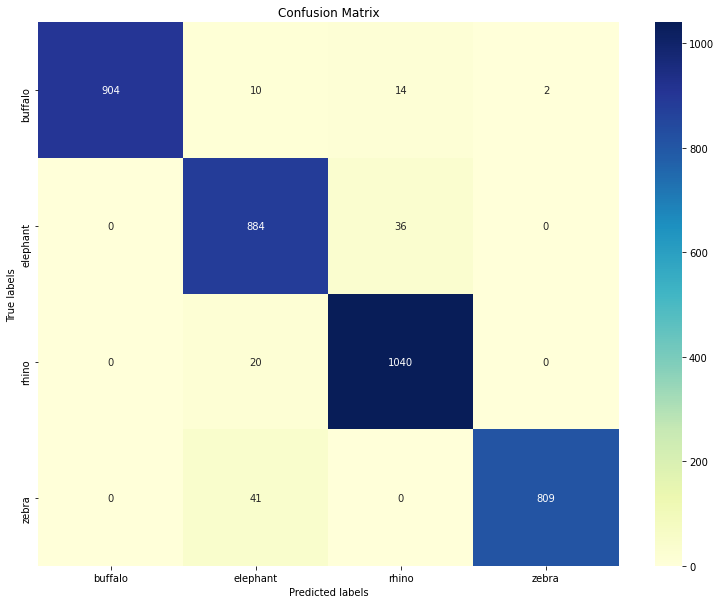

In [ ]:
c_model = SVC(C =10, gamma= 0.001, kernel= 'rbf')
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))
for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y como parametros: C =10, gamma= 0.001, kernel= rbf' )
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);

#Neurona compuesta ResNet152V2 - random forest

In [ ]:
param_grid = [
  {'n_estimators' : [10,50,100,200],
   'max_depth' : [4,8,12],
   'min_samples_split': [1,3,5],
   'min_samples_leaf': [1,3,5]}]
model_c = RandomForestClassifier()

model_c_cv = GridSearchCV(model_c,param_grid,cv=10,n_jobs=-1)
model_c_cv.fit(X_train,y_train)


GridSearchCV(cv=10, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                              oob_score=False,
                                              rand

In [ ]:
print(model_c_cv.best_score_,model_c_cv.best_params_)

0.9608802149178255 {'max_depth': 12, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 50}


El accuracy es de 94.66498103666245% utilizando cross validation y como parametros: max_depth: 12, min_samples_leaf: 1, min_samples_split: 3, n_estimators: 50




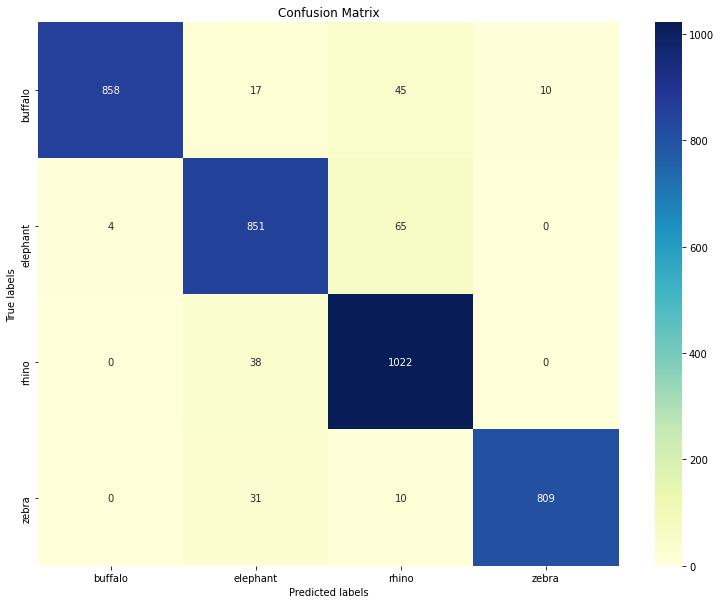

In [ ]:
params = {'max_depth': 12, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 50}
c_model = RandomForestClassifier(**params)
strtfdKFold = StratifiedKFold(n_splits=10)
kfold = strtfdKFold.split(X_train, y_train)
scores = []
matriz1 = np.zeros((4,4))

for train_index, test_index in kfold:
  X_train_cv, X_test_cv = X_train[train_index], X_train[test_index]
  y_train_cv, y_test_cv = y_train[train_index], y_train[test_index]
  c_model.fit(X_train_cv, y_train_cv)
  y_pred = c_model.predict(X_test)
  matriz1 = matriz1 + confusion_matrix(y_test, y_pred)
  scores.append(c_model.score(X_test_cv,y_test_cv))
accuracy=np.mean(scores)*100

print(f'El accuracy es de {accuracy}% utilizando cross validation y como parametros: max_depth: 12, min_samples_leaf: 1, min_samples_split: 3, n_estimators: 50' )
print('')
print('')

plt.figure(figsize=(13,10))
ax = plt.subplot()
sns.heatmap(matriz1, annot=True, fmt='g', ax=ax,cmap="YlGnBu");
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels); ax.yaxis.set_ticklabels(labels);